# CAMSHIFT

Official paper: Computer Vision Face Tracking For Use in a Perceptual User Interface in KVV -> http://opencv.jp/opencv-1.0.0_org/docs/papers/camshift.pdf

Dataset: https://www.youtube.com/watch?v=t60Rxr5sF14

For more information regarding the implementation, see the blog review: https://medium.com/@claudio.vindimian/understanding-and-implementing-the-camshift-object-tracking-algorithm-python-81587c24eda8

In [20]:
from skimage import io
import numpy as np
import matplotlib.colors as colors
from matplotlib import pyplot as plt
import cv2
import math

In [8]:
MIN_SATURATION = 0.2
MIN_VALUE = 0.5
MIN_PROB = 0.21
nbins = 256

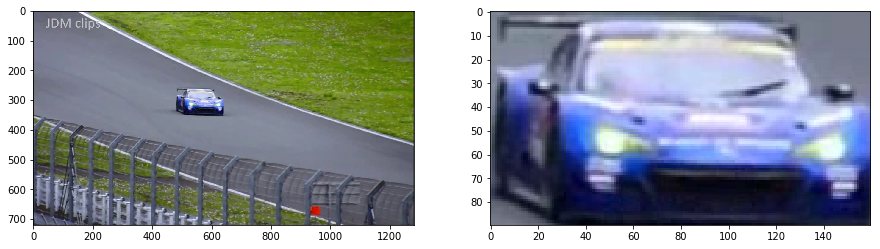

In [9]:
image = io.imread('images/racecar.png')
imageCar = image[260:350, 480:640]

fig = plt.figure(figsize=(15, 10))
ax1 = plt.subplot(1, 2, 1)
ax2 = plt.subplot(1, 2, 2)

ax1.imshow(image)
ax2.imshow(imageCar)

In [10]:
def create_color_histogram(img, bin_count = 256, out = plt):
    img=(img.astype(float))/255.0
    
    img_hsv = colors.rgb_to_hsv(img[...,:3])
    img_hsv=img_hsv[...,0].flatten()
    
    return out.hist(img_hsv*360,bin_count,range=(0.,360.), label='Hue')

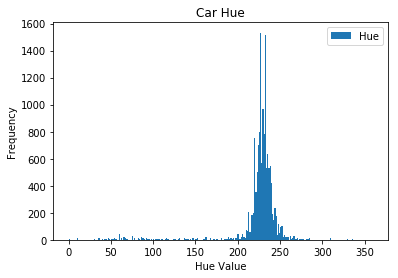

In [11]:
create_color_histogram(imageCar)

plt.title("Car Hue")
plt.xlabel("Hue Value")
plt.ylabel("Frequency")
plt.legend()
plt.savefig('car_histogram.jpg',bbox_inches='tight')
plt.show()



In [12]:
def min_max_scaling(histogram_values):
    mn, mx = histogram_values.min(), histogram_values.max()
    return (histogram_values - mn) / (mx - mn)

In [13]:
def create_prob_distr(img, histogram, min_saturation, min_value, min_prob):


    (h_values,bin_edges,n) = histogram
    
    h_values=min_max_scaling(h_values)

    img=(img.astype(float))/255.0
    img_hsv = colors.rgb_to_hsv(img[...,:3])
    
    prob_distr=np.zeros((img_hsv.shape[0], img_hsv.shape[1]))
    
    for i in range(img_hsv.shape[0]):
        for j in range(img_hsv.shape[1]):
            bin_index = np.digitize(img_hsv[i][j][0]*360,bin_edges, right=True)
            if(img_hsv[i][j][1] < min_saturation or img_hsv[i][j][2] < min_value or 
               h_values[bin_index-1] < min_prob):
                prob_distr[i][j] = 0.0
            else:
                    prob_distr[i][j] = h_values[bin_index-1]
    return prob_distr

/anaconda3/lib/python3.6/site-packages/skimage/io/_plugins/matplotlib_plugin.py:51: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  out_of_range_float = (np.issubdtype(image.dtype, np.float) and


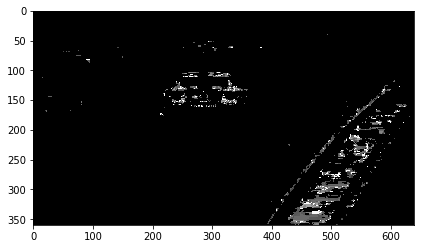

In [14]:
lastFrame = io.imread('images/racecar/151.jpeg')




histogramCar = create_color_histogram(imageCar, out=ax1)

probDistr = create_prob_distr(lastFrame, histogramCar, MIN_SATURATION, MIN_VALUE,0.21)
io.imshow(probDistr)
plt.savefig('prob_distr.jpg',bbox_inches='tight')




In [15]:
def get_area_from_roi(img, roi):
    return img[roi[1]:roi[1]+roi[3],roi[0]:roi[0]+roi[2]]

In [16]:
def compute_moments(img, i, j):
    moment = 0
    for x, row in enumerate(img):
        for y, pixel in enumerate(row):
            moment = moment + ( x**i*y**j * pixel )
    return moment

In [17]:
def compute_new_roi(roi, new_centroid):
    img_new_centroid = (new_centroid[0]+roi[0], new_centroid[1]+roi[1])
    x = abs( img_new_centroid[0] - (roi[2]/2) )
    y = abs ( img_new_centroid[1] - (roi[3]/2) )
    return int(x),int(y),roi[2],roi[3]

In [18]:
def camshift(prob_distr, roi):
    iter_count = 0
    centroids_history = list()

    while True:
        roi_prob_distr = get_area_from_roi(prob_distr,roi)
        
        m00 = compute_moments(roi_prob_distr,0,0)
        m10 = compute_moments(roi_prob_distr,1,0)
        m01 = compute_moments(roi_prob_distr,0,1)
        
        if(m00==0):
            break;
        
        xc = m10/m00
        yc = m01/m00
        new_roi = compute_new_roi(roi, (yc,xc))
        
        centroids_history.append( ( yc+roi[0], xc+roi[1]) )
        
        if( (abs(new_roi[0]-roi[0])<2 and 
             abs(new_roi[1]-roi[1])<2) or iter_count > 20):
            
            s = 2*math.sqrt(m00)
            roi = (new_roi[0],new_roi[1],int(s * 1.5),int(s))
            break;
        
        roi = new_roi
        iter_count += 1
    return roi, centroids_history

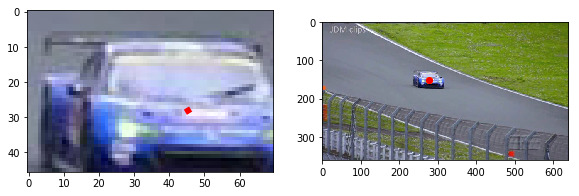

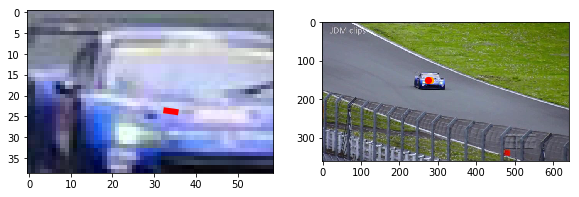

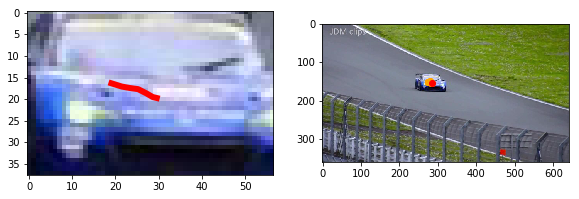

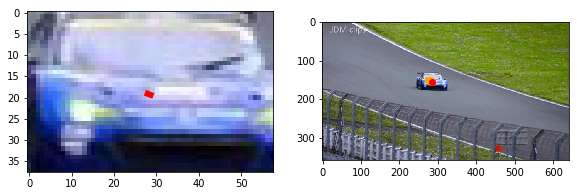

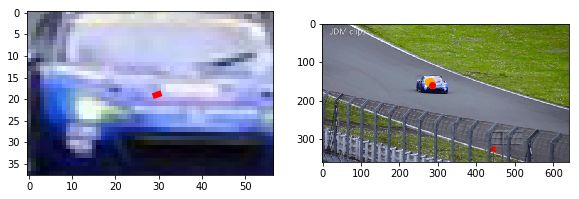

...

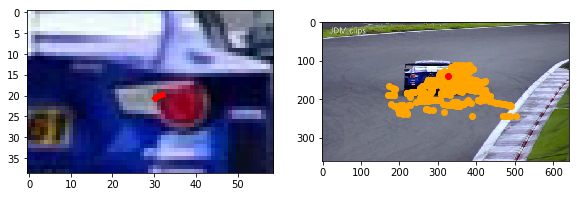

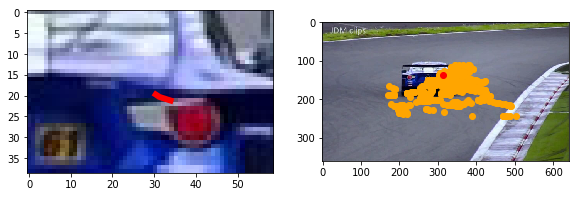

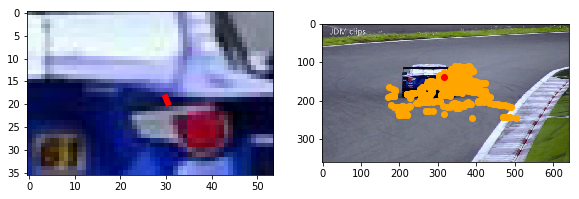

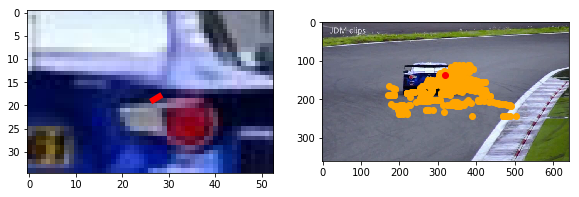

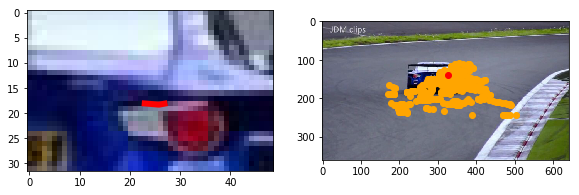

error: OpenCV(4.1.1) /Users/travis/build/skvark/opencv-python/opencv/modules/imgproc/src/color.cpp:182: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'


In [21]:
roi = (230,122,90,56) 
total_centroids_history = list()
img = io.imread('images/racecar.png')

frame_roi = get_area_from_roi(img, (480, 260, 160, 90))
histo_lookup = create_color_histogram(frame_roi, nbins) 
plt.close()

cap = cv2.VideoCapture("images/racecar/%03d.jpeg") 
while cap.isOpened():
    ret,img = cap.read()
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) 
   

    fig = plt.figure(figsize=(15, 10))
    ax1 = plt.subplot(1, 3, 1)
    ax2 = plt.subplot(1, 3, 2)
    
    prob_distr = create_prob_distr(img, histo_lookup, MIN_SATURATION, MIN_VALUE, MIN_PROB)
    
    roi, centroids_history = camshift(prob_distr, roi)
    
    total_centroids_history.extend(centroids_history)
    x2, y2 = zip(*total_centroids_history)
    centroids_hystory1 = list(map(lambda x: (x[0]-roi[0], x[1]-roi[1]), centroids_history))
    x, y = zip(*centroids_hystory1)
    
    ax1.plot(x,y, color='red', lw='6')
    ax2.scatter(x2,y2, color='orange')
    ax2.scatter(x2[-1],y2[-1], color='red')
    ax1.imshow(get_area_from_roi(img, roi))
    ax2.imshow(img)
    plt.show()